<a href="https://www.kaggle.com/code/risakashiwabara/eda-store-sales-time03?scriptVersionId=147844547" target="_blank"><img align="left" alt="Kaggle" title="Open in Kaggle" src="https://kaggle.com/static/images/open-in-kaggle.svg"></a>

<!-- We are aiming to become a data scientist. 
Please comment if there are areas that need improvement. 
We will update this page every Thursday -->

**We are aiming to become a data scientist.  
Please comment if there are areas that need improvement.　
We will update this page every Thursday. **

# data

In [1]:
import numpy as np
import pandas as pd 
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.5
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [2]:
df_stores = pd.read_csv('/kaggle/input/store-sales-time-series-forecasting/stores.csv')
df_holidays_ev = pd.read_csv('/kaggle/input/store-sales-time-series-forecasting/holidays_events.csv')
df_oil = pd.read_csv('/kaggle/input/store-sales-time-series-forecasting/oil.csv')
df_submit = pd.read_csv('/kaggle/input/store-sales-time-series-forecasting/sample_submission.csv')
df_test = pd.read_csv('/kaggle/input/store-sales-time-series-forecasting/test.csv')
df_train = pd.read_csv('/kaggle/input/store-sales-time-series-forecasting/train.csv')
df_transactions = pd.read_csv('/kaggle/input/store-sales-time-series-forecasting/transactions.csv')

# columns_unique

In [3]:
list_df = [df_train,df_stores,df_holidays_ev,df_oil,df_transactions]
for df in list_df:
    df_columns = df.columns
    for columns in df_columns:
        columns_unique = df[columns].unique()
        print('--'*10+columns +'--'*10)
        print(columns_unique)

--------------------id--------------------
[      0       1       2 ... 3000885 3000886 3000887]
--------------------date--------------------
['2013-01-01' '2013-01-02' '2013-01-03' ... '2017-08-13' '2017-08-14'
 '2017-08-15']
--------------------store_nbr--------------------
[ 1 10 11 12 13 14 15 16 17 18 19  2 20 21 22 23 24 25 26 27 28 29  3 30
 31 32 33 34 35 36 37 38 39  4 40 41 42 43 44 45 46 47 48 49  5 50 51 52
 53 54  6  7  8  9]
--------------------family--------------------
['AUTOMOTIVE' 'BABY CARE' 'BEAUTY' 'BEVERAGES' 'BOOKS' 'BREAD/BAKERY'
 'CELEBRATION' 'CLEANING' 'DAIRY' 'DELI' 'EGGS' 'FROZEN FOODS' 'GROCERY I'
 'GROCERY II' 'HARDWARE' 'HOME AND KITCHEN I' 'HOME AND KITCHEN II'
 'HOME APPLIANCES' 'HOME CARE' 'LADIESWEAR' 'LAWN AND GARDEN' 'LINGERIE'
 'LIQUOR,WINE,BEER' 'MAGAZINES' 'MEATS' 'PERSONAL CARE' 'PET SUPPLIES'
 'PLAYERS AND ELECTRONICS' 'POULTRY' 'PREPARED FOODS' 'PRODUCE'
 'SCHOOL AND OFFICE SUPPLIES' 'SEAFOOD']
--------------------sales--------------------
[0

# data_merge

In [4]:
df_holidays_ev = df_holidays_ev.rename(columns={'type': 'holiday_type'})
df_stores = df_stores.rename(columns={'type': 'store_type'})
df_train = df_train.merge(df_stores, on ='store_nbr')
df_train = df_train.merge(df_oil, on = 'date',how='left')
df = df_train.merge(df_holidays_ev, on ='date',how='left')
df_ = df.drop_duplicates()
df_

,id,date,store_nbr,family,sales,onpromotion,city,state,store_type,cluster,dcoilwtico,holiday_type,locale,locale_name,description,transferred
0,0,2013-01-01,1,AUTOMOTIVE,0.000,0,Quito,Pichincha,D,13,NaN,Holiday,National,Ecuador,Primer dia del ano,False
1,1,2013-01-01,1,BABY CARE,0.000,0,Quito,Pichincha,D,13,NaN,Holiday,National,Ecuador,Primer dia del ano,False
2,2,2013-01-01,1,BEAUTY,0.000,0,Quito,Pichincha,D,13,NaN,Holiday,National,Ecuador,Primer dia del ano,False
3,3,2013-01-01,1,BEVERAGES,0.000,0,Quito,Pichincha,D,13,NaN,Holiday,National,Ecuador,Primer dia del ano,False
4,4,2013-01-01,1,BOOKS,0.000,0,Quito,Pichincha,D,13,NaN,Holiday,National,Ecuador,Primer dia del ano,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3054343,3000883,2017-08-15,9,POULTRY,438.133,0,Quito,Pichincha,B,6,47.57,Holiday,Local,Riobamba,Fundacion de Riobamba,False
3054344,3000884,2017-08-15,9,PREPARED FOODS,154.553,1,Quito,Pichincha,B,6,47.57,Holiday,Local,Riobamba,Fundacion de Riobamba,False
3054345,3000885,2017-08-15,9,PRODUCE,2419.729,148,Quito,Pichincha,B,6,47.57,Holiday,Local,Riobamba,Fundacion de Riobamba,False
3054346,3000886,2017-08-15,9,SCHOOL AND OFFICE SUPPLIES,121.000,8,Quito,Pichincha,B,6,47.57,Holiday,Local,Riobamba,Fundacion de Riobamba,False


# --①graph--（sales×ID）

In [5]:
left = df_['id']
height = df_['sales']
print(df_[['id']].dtypes)
# plt.plot(left, height)

id    int64
dtype: object


# --➁graph--（sales×df_traincolumns）

id


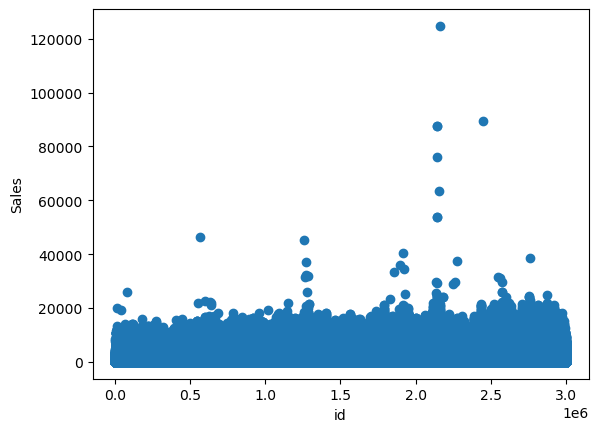

store_nbr


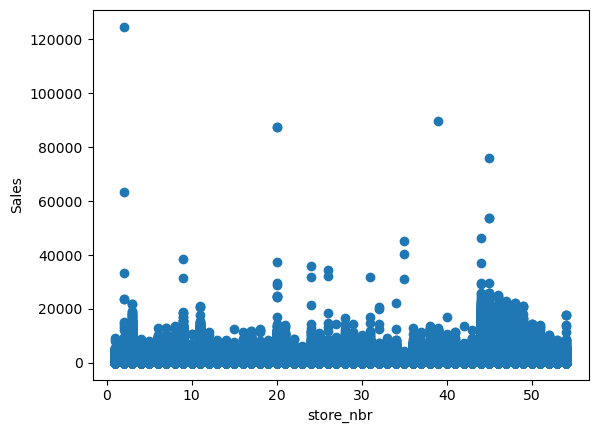

sales


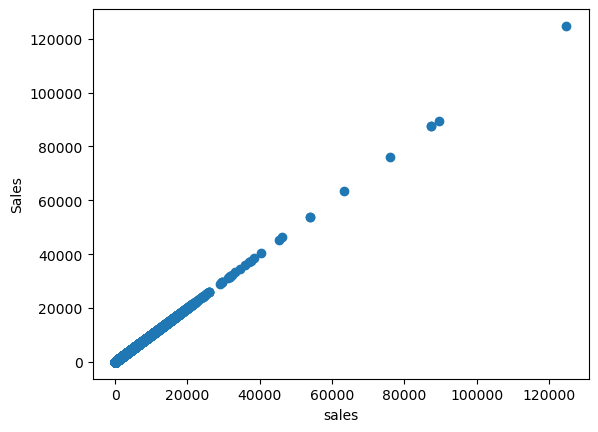

onpromotion


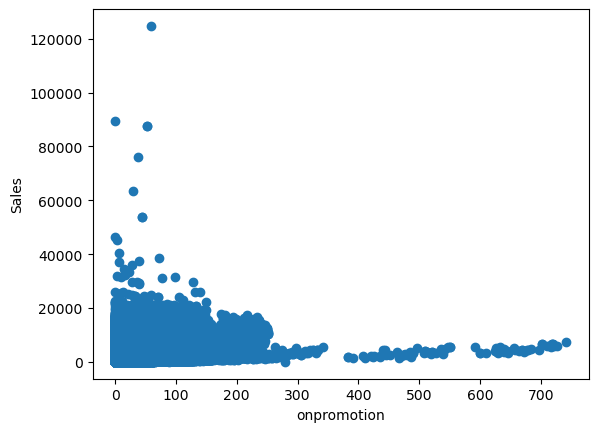

cluster


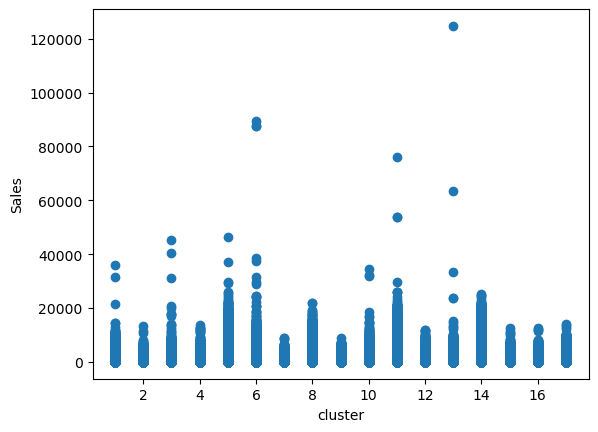

dcoilwtico


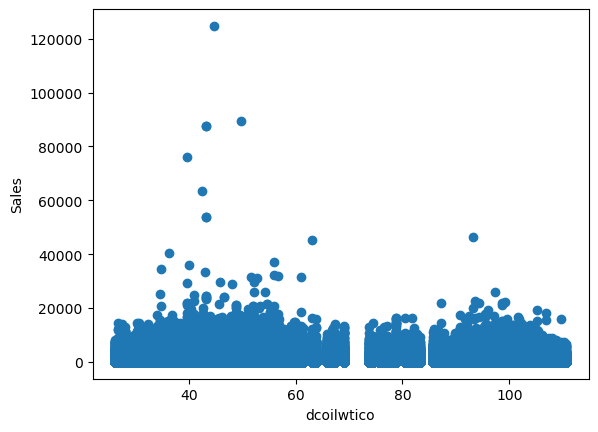

In [6]:
df_number = df_.select_dtypes(include=np.number)
i = df_number.columns
for a in i:
    print(a)
    plt.scatter(df_[a],df_['sales'])
    plt.xlabel(a)
    plt.ylabel("Sales")
    plt.show()
 

# --③graph--（sales×maeged df_）

In [7]:
df_['holiday_type']

0          Holiday
1          Holiday
2          Holiday
3          Holiday
4          Holiday
            ...   
3054343    Holiday
3054344    Holiday
3054345    Holiday
3054346    Holiday
3054347    Holiday
Name: holiday_type, Length: 3054348, dtype: object

date


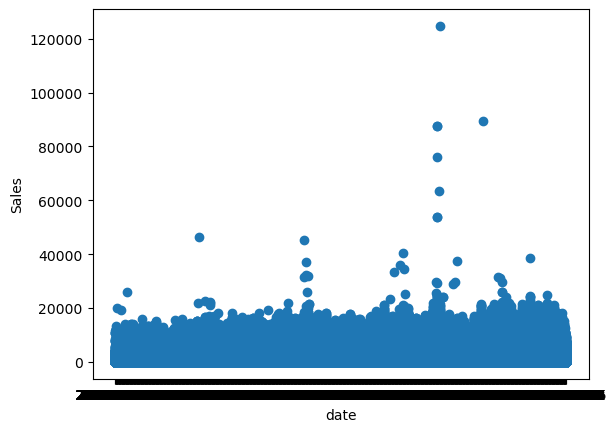

family


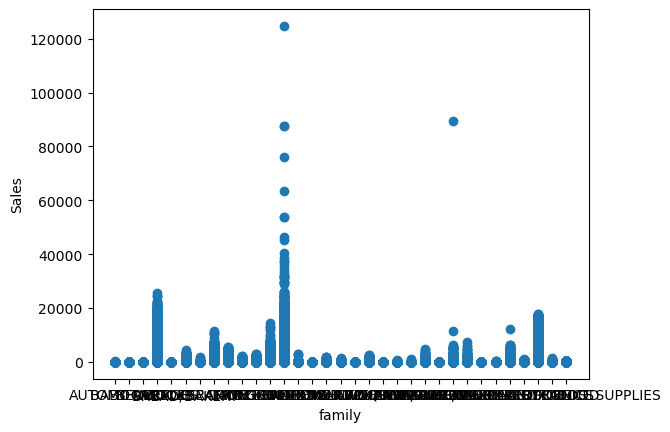

city


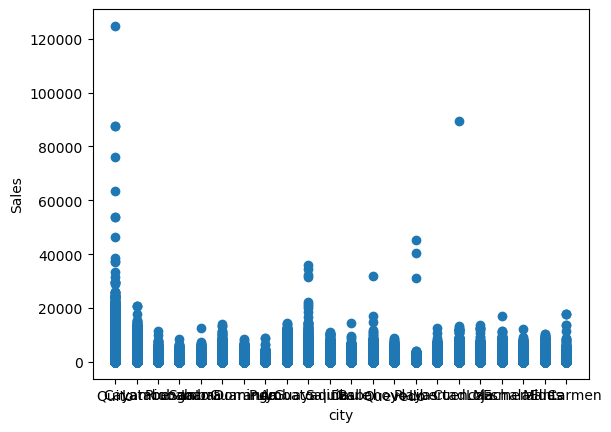

state


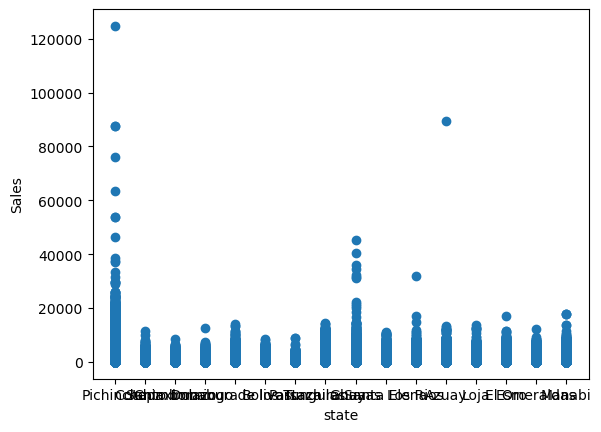

store_type


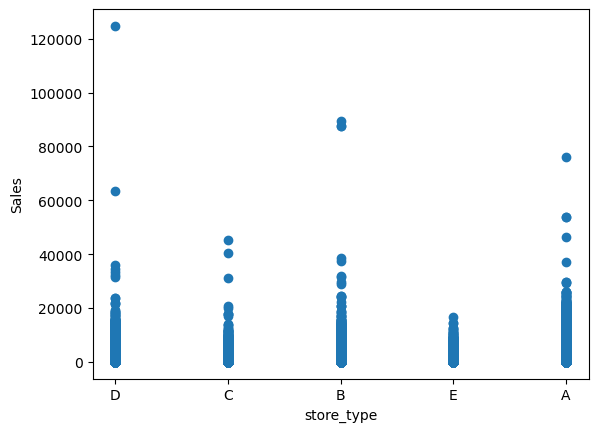

In [8]:
df_object = df_.select_dtypes(include=object)
df_object = df_object.drop(['holiday_type','locale','description','transferred','locale_name'], axis=1)
i = df_object.columns
for columns in i:
    print(columns)
    plt.scatter (df_[columns],df_['sales'])
    plt.xlabel(columns)
    plt.ylabel("Sales")
    plt.show()

# --④graph--（sales×numerical value）

In [9]:
train_aux = df_[['date', 'sales', 'dcoilwtico','onpromotion']].groupby('date').mean()
train_aux = train_aux.reset_index()


graph1 = go.Scatter(x=train_aux['date'], y=train_aux['dcoilwtico'],marker_color='blue', text="sales")
graph2 = go.Scatter(x=train_aux['date'], y=train_aux['sales'],marker_color='red', text="sales")
graph3 = go.Scatter(x=train_aux['date'], y=train_aux['onpromotion'],marker_color='yellow', text="sales")


fig = go.Figure().set_subplots(rows=3, cols=3)

fig.append_trace(graph1, row=1, col=1)
fig.update_layout({"title": f'Avg Sales by date for all stores and products',
                   "xaxis": {"title":"Date"},
                   "yaxis": {"title":"Avg Unit Sold"},
                   "showlegend": False})

fig.append_trace(graph2, row=1, col=2)
fig.append_trace(graph3, row=2, col=1)




with open('./plotly10-1.txt', 'w') as f:
     f.write(fig.to_html(include_plotlyjs='cdn',full_html=False))


fig.show()

## --⑤graph--（sales×onpromotion）

In [10]:
fig = px.scatter(df_[df_['dcoilwtico'] > 0], x="dcoilwtico", y="sales", color='sales', 
                           color_continuous_scale="earth",
                 size='sales', log_x=True, size_max=30)

fig.update_layout({"title": f'Correlation between OnPromotion and Sales (total avg sales and promotion each day)',
                   "xaxis": {"title":"On Promotion"},
                   "yaxis": {"title":"Sales"},
                   "showlegend": False})
fig.show()